This notebook purpose is to prepare and explore dataset of patients no show appointments. The dataset is from Kaggle and can be found here: https://www.kaggle.com/joniarroba/noshowappointments


## No Show Appointments Dataset Exploration and Preparation

### Import libraries

In [83]:
import polars as pl
import plotly.express as px
import pandas as pd

### Load dataset using Polars

Dataset can be downloaded from [here](https://www.kaggle.com/datasets/joniarroba/noshowappointments).

In [15]:
dtypes = {
    "PatientId": pl.Utf8,
    "AppointmentID": pl.UInt32,
    "Gender": pl.Utf8,
    "ScheduledDay": pl.Utf8,
    "AppointmentDay": pl.Utf8,
    "Age": pl.UInt8,
    "Neighbourhood": pl.Utf8,
    "Scholarship": pl.UInt8,
    "Hipertension": pl.UInt8,
    "Diabetes": pl.UInt8,
    "Alcoholism": pl.UInt8,
    "Handcap": pl.UInt8,
    "SMS_received": pl.UInt8,
    "No-show": pl.Utf8,
}

%time
df = pl.read_csv("data/KaggleV2-May-2016.csv", dtypes=dtypes)

CPU times: user 1 µs, sys: 1e+03 ns, total: 2 µs
Wall time: 4.05 µs


### Inspect dataset

In [3]:
df.head(5)

PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
str,u32,str,str,str,u8,str,u8,u8,u8,u8,u8,u8,str
"""29872499824296...",5642903,"""F""","""2016-04-29T18:...","""2016-04-29T00:...",62,"""JARDIM DA PENH...",0,1,0,0,0,0,"""No"""
"""55899777669443...",5642503,"""M""","""2016-04-29T16:...","""2016-04-29T00:...",56,"""JARDIM DA PENH...",0,0,0,0,0,0,"""No"""
"""4262962299951""",5642549,"""F""","""2016-04-29T16:...","""2016-04-29T00:...",62,"""MATA DA PRAIA""",0,0,0,0,0,0,"""No"""
"""867951213174""",5642828,"""F""","""2016-04-29T17:...","""2016-04-29T00:...",8,"""PONTAL DE CAMB...",0,0,0,0,0,0,"""No"""
"""8841186448183""",5642494,"""F""","""2016-04-29T16:...","""2016-04-29T00:...",56,"""JARDIM DA PENH...",0,1,1,0,0,0,"""No"""


In [4]:
df.tail(5)

PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
str,u32,str,str,str,u8,str,u8,u8,u8,u8,u8,u8,str
"""2572134369293""",5651768,"""F""","""2016-05-03T09:...","""2016-06-07T00:...",56,"""MARIA ORTIZ""",0,0,0,0,0,1,"""No"""
"""3596266328735""",5650093,"""F""","""2016-05-03T07:...","""2016-06-07T00:...",51,"""MARIA ORTIZ""",0,0,0,0,0,1,"""No"""
"""15576631729893...",5630692,"""F""","""2016-04-27T16:...","""2016-06-07T00:...",21,"""MARIA ORTIZ""",0,0,0,0,0,1,"""No"""
"""92134931435557...",5630323,"""F""","""2016-04-27T15:...","""2016-06-07T00:...",38,"""MARIA ORTIZ""",0,0,0,0,0,1,"""No"""
"""37751151812112...",5629448,"""F""","""2016-04-27T13:...","""2016-06-07T00:...",54,"""MARIA ORTIZ""",0,0,0,0,0,1,"""No"""


In [5]:
df.columns

['PatientId',
 'AppointmentID',
 'Gender',
 'ScheduledDay',
 'AppointmentDay',
 'Age',
 'Neighbourhood',
 'Scholarship',
 'Hipertension',
 'Diabetes',
 'Alcoholism',
 'Handcap',
 'SMS_received',
 'No-show']

In [6]:
df.shape

(110527, 14)

The dataset contains 110527 rows and 14 columns associated with 110527 medical appointments in Brazil and is focused on the question of whether or not patients show up for their appointment. A number of characteristics about the patient are included in each row.

### Load dataset using Pandas

In [1]:
import pandas as pd


%time
df = pd.read_csv("data/KaggleV2-May-2016.csv")

CPU times: user 1 µs, sys: 0 ns, total: 1 µs
Wall time: 2.62 µs


In [2]:
from collections import Counter


print(Counter(df["No-show"]))

Counter({'No': 88208, 'Yes': 22319})


In [85]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 110527 entries, 0 to 110526
Data columns (total 14 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   PatientId       110527 non-null  float64
 1   AppointmentID   110527 non-null  int64  
 2   Gender          110527 non-null  object 
 3   ScheduledDay    110527 non-null  object 
 4   AppointmentDay  110527 non-null  object 
 5   Age             110527 non-null  int64  
 6   Neighbourhood   110527 non-null  object 
 7   Scholarship     110527 non-null  int64  
 8   Hipertension    110527 non-null  int64  
 9   Diabetes        110527 non-null  int64  
 10  Alcoholism      110527 non-null  int64  
 11  Handcap         110527 non-null  int64  
 12  SMS_received    110527 non-null  int64  
 13  No-show         110527 non-null  object 
dtypes: float64(1), int64(8), object(5)
memory usage: 11.8+ MB


### Visualize and inspect dataset features

#### Age

In [86]:
fig = px.histogram(df, x=df['Age'], nbins=100)
fig.update_xaxes(title_text='Age')
fig.show()

In [87]:
print(f"Number of unique values in Age: {df['Age'].nunique()}")
print(f"Age range: ({df['Age'].min()} - {df['Age'].max()})")
print(f"Mean age: {round(df['Age'].mean(), 2)}")
print(f"Median age: {df['Age'].median()}")
print(f"Standard deviation: {round(df['Age'].std(), 2)}")

Number of unique values in Age: 104
Age range: (-1 - 115)
Mean age: 37.09
Median age: 37.0
Standard deviation: 23.11


In [88]:
df[df['Age'] == -1]

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
99832,4.659432e+14,5775010,F,2016-06-06T08:58:13Z,2016-06-06T00:00:00Z,-1,ROMÃO,0,0,0,0,0,0,No


In [89]:
df[df['Age'] == 115]

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
63912,3.196321e+13,5700278,F,2016-05-16T09:17:44Z,2016-05-19T00:00:00Z,115,ANDORINHAS,0,0,0,0,1,0,Yes
63915,3.196321e+13,5700279,F,2016-05-16T09:17:44Z,2016-05-19T00:00:00Z,115,ANDORINHAS,0,0,0,0,1,0,Yes
68127,3.196321e+13,5562812,F,2016-04-08T14:29:17Z,2016-05-16T00:00:00Z,115,ANDORINHAS,0,0,0,0,1,0,Yes
76284,3.196321e+13,5744037,F,2016-05-30T09:44:51Z,2016-05-30T00:00:00Z,115,ANDORINHAS,0,0,0,0,1,0,No
97666,7.482346e+14,5717451,F,2016-05-19T07:57:56Z,2016-06-03T00:00:00Z,115,SÃO JOSÉ,0,1,0,0,0,1,No


Analyzing the age distribution of the patients, it can be seen that the majority of the patients are within age range of 0-50 years old. The distribution is right skewed.

In [90]:
fig = px.histogram(df, x=df['Gender'])
fig.update_xaxes(title_text='Gender')
fig.show()

The number of females is higher than the number of males in the dataset. This may indicate that women take greater care of their health.

#### Scholarship

In [91]:
fig = px.pie(df, values=df['Scholarship'].value_counts(), names=df['Scholarship'].value_counts().index)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(title_text='Scholarship')

The number of patients who are enrolled in Brasilian welfare program Bolsa Família is higher than the number of patients who are not enrolled in the program.

In [24]:
# print unique values in Scholarship
print(f"Unique values in Scholarship: {df['Scholarship'].unique()}")

Unique values in Scholarship: [0 1]


#### Neighbourhood 

In [25]:
fig = px.histogram(df, x=df['Neighbourhood'])
fig.update_xaxes(title_text='Neighbourhood')
fig.show()

Jardim Camburi is the neighborhood with the highest number of appointments.

#### Handicap


In [25]:
fig = px.histogram(df, x=df['Handcap'])
fig.update_xaxes(title_text='Handcap')
fig.show()

In [29]:
# print unique values in Handcap and the number of values
print(f"Unique values in Handcap: {df['Handcap'].unique()}")
print(f"Number of values in Handcap:\n{df['Handcap'].value_counts()}")

Unique values in Handcap: [0 1 2 3 4]
Number of values in Handcap:
0    108286
1      2042
2       183
3        13
4         3
Name: Handcap, dtype: int64


The number of patients who are not handicapped is higher than the number of patients who are handicapped.

#### Hipertension

In [94]:
# add pie chart for Hipertension
fig = px.pie(df, values=df['Hipertension'].value_counts(), names=df['Hipertension'].value_counts().index)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(title_text='Hipertension')
fig.show()

The patients who are not hypertensive are more than the patients who are hypertensive.

In [41]:
px.histogram(df, x='Hipertension', color='Gender', barmode='group',
             color_discrete_sequence=['#F8766D', '#00BA38'])

#### Diabetes

In [95]:
# add pie chart for Diabetes
fig = px.pie(df, values=df['Diabetes'].value_counts(), names=df['Diabetes'].value_counts().index)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(title_text='Diabetes')
fig.show()

In [39]:
px.histogram(df, x='Diabetes', color='Gender', barmode='group',
             color_discrete_sequence=['#F8766D', '#00BA38'])

#### Alcoholism

In [96]:
# add pie chart for Alcoholism
fig = px.pie(df, values=df['Alcoholism'].value_counts(), names=df['Alcoholism'].value_counts().index)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(title_text='Alcoholism')

In [40]:
px.histogram(df, x='Alcoholism', color='Gender', barmode='group',
             color_discrete_sequence=['#F8766D', '#00BA38'])

#### SMS_received

In [78]:
fig = px.pie(df, values=df['SMS_received'].value_counts(), names=df['SMS_received'].unique())
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(title_text='SMS_received')
fig.update_traces(marker=dict(line=dict(color='#000000', width=2)))
fig.show()

In [47]:
px.histogram(df, x='SMS_received', color='Gender', barmode='group',
             color_discrete_sequence=['#F8766D', '#00BA38'])

#### Patient ID


In [58]:
# print the range of patient IDs
print(f"Patient ID range: ({df['PatientId'].min()} - {df['PatientId'].max()})")
print(f"Number of unique values in PatientId: {df['PatientId'].nunique()}")

Patient ID range: (39217.84439 - 999981631772427.0)
Number of unique values in PatientId: 62299


#### Appointment ID

In [60]:
print(f"Appointment ID range: ({df['AppointmentID'].min()} - {df['AppointmentID'].max()})")
print(f"Number of unique values in AppointmentID: {df['AppointmentID'].nunique()}")

Appointment ID range: (5030230 - 5790484)
Number of unique values in AppointmentID: 110527


***
#### Target variable - No Show

The target variable is No Show. It is a binary variable with values of Yes and No.

In [44]:
fig = px.histogram(df, x=df['No-show'])
fig.update_xaxes(title_text='No-show')
fig.show()

In [76]:
fig = px.pie(df, values=df['No-show'].value_counts(), names=df['No-show'].unique())
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_traces(marker=dict(line=dict(color='#000000', width=2)))
fig.update_layout(title_text='No-show')
fig.show()


As can be seen in the above figure, the distribution of the target variable is not balanced. Data is imbalanced, as the number of patients who showed up for their appointment is much lower than the number of patients who did not show up. This will needed to be taken  into account when training classification models or in preprocessing the data. 

In [42]:
px.histogram(df.to_pandas(), x='No-show', color='Gender', barmode='group',
             color_discrete_sequence = px.colors.qualitative.Alphabet)

### Verify validity of data

In [50]:
df.isnull().sum()

PatientId         0
AppointmentID     0
Gender            0
ScheduledDay      0
AppointmentDay    0
Age               0
Neighbourhood     0
Scholarship       0
Hipertension      0
Diabetes          0
Alcoholism        0
Handcap           0
SMS_received      0
No-show           0
dtype: int64

There are no missing values in the dataset.

In [52]:
df.nunique()

PatientId          62299
AppointmentID     110527
Gender                 2
ScheduledDay      103549
AppointmentDay        27
Age                  104
Neighbourhood         81
Scholarship            2
Hipertension           2
Diabetes               2
Alcoholism             2
Handcap                5
SMS_received           2
No-show                2
dtype: int64

In [66]:
df.duplicated().sum()


0

The number of unique values in 110527 rows is equal to the number of rows, which means that there are no duplicate rows in the dataset.

#### Check for invalid values

In [54]:
for col in df.columns:
    if col not in ['PatientId', 'AppointmentID', 'ScheduledDay', 'AppointmentDay']:
        print(f"{col}: {df[col].unique()}")

Gender: ['F' 'M']
Age: [ 62  56   8  76  23  39  21  19  30  29  22  28  54  15  50  40  46   4
  13  65  45  51  32  12  61  38  79  18  63  64  85  59  55  71  49  78
  31  58  27   6   2  11   7   0   3   1  69  68  60  67  36  10  35  20
  26  34  33  16  42   5  47  17  41  44  37  24  66  77  81  70  53  75
  73  52  74  43  89  57  14   9  48  83  72  25  80  87  88  84  82  90
  94  86  91  98  92  96  93  95  97 102 115 100  99  -1]
Neighbourhood: ['JARDIM DA PENHA' 'MATA DA PRAIA' 'PONTAL DE CAMBURI' 'REPÚBLICA'
 'GOIABEIRAS' 'ANDORINHAS' 'CONQUISTA' 'NOVA PALESTINA' 'DA PENHA'
 'TABUAZEIRO' 'BENTO FERREIRA' 'SÃO PEDRO' 'SANTA MARTHA' 'SÃO CRISTÓVÃO'
 'MARUÍPE' 'GRANDE VITÓRIA' 'SÃO BENEDITO' 'ILHA DAS CAIEIRAS'
 'SANTO ANDRÉ' 'SOLON BORGES' 'BONFIM' 'JARDIM CAMBURI' 'MARIA ORTIZ'
 'JABOUR' 'ANTÔNIO HONÓRIO' 'RESISTÊNCIA' 'ILHA DE SANTA MARIA'
 'JUCUTUQUARA' 'MONTE BELO' 'MÁRIO CYPRESTE' 'SANTO ANTÔNIO' 'BELA VISTA'
 'PRAIA DO SUÁ' 'SANTA HELENA' 'ITARARÉ' 'INHANGUETÁ' 'UNIVE

In [55]:
df[df['Age'] == -1]

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
99832,4.659432e+14,5775010,F,2016-06-06T08:58:13Z,2016-06-06T00:00:00Z,-1,ROMÃO,0,0,0,0,0,0,No


There is a record with age of -1. This is an invalid value. This record will be removed from the dataset.

## Data cleaning and further inspection

In [113]:
df = pd.read_csv("data/KaggleV2-May-2016.csv")

### Remove invalid values

In [114]:
df[df['Age'] < 0]

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
99832,4.659432e+14,5775010,F,2016-06-06T08:58:13Z,2016-06-06T00:00:00Z,-1,ROMÃO,0,0,0,0,0,0,No


In [115]:
# remove the rows with negative age
df = df[df['Age'] >= 0]

In [116]:
df[df['Age'] < 0]

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show


### Replace target variable values and change to more convenient name

In [117]:
# replacing No-show by Show, Yes by 0, and No by 1
df.rename(columns={'No-show': 'Show'}, inplace=True)
df.loc[df['Show'] == 'Yes', ['Show']] = 0
df.loc[df['Show'] == 'No', ['Show']] = 1

In [118]:
df.head(2)

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,Show
0,2.987250e+13,5642903,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,1
1,5.589978e+14,5642503,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,0,0,0,0,0,1


In [119]:
fig = px.pie(df, values=df['Show'].value_counts(), names=df['Show'].unique())
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_traces(marker=dict(line=dict(color='#000000', width=2)))
fig.update_layout(title_text='Show')
fig.show()

### Rename columns that contain typos

In [120]:
# rename the columns
df = df.rename(columns={'Hipertension': 'Hypertension', 'Handcap': 'Handicap'})
df.head(5)

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show
0,2.987250e+13,5642903,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,1
1,5.589978e+14,5642503,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,0,0,0,0,0,1
2,4.262962e+12,5642549,F,2016-04-29T16:19:04Z,2016-04-29T00:00:00Z,62,MATA DA PRAIA,0,0,0,0,0,0,1
3,8.679512e+11,5642828,F,2016-04-29T17:29:31Z,2016-04-29T00:00:00Z,8,PONTAL DE CAMBURI,0,0,0,0,0,0,1
4,8.841186e+12,5642494,F,2016-04-29T16:07:23Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,1,1,0,0,0,1


### Feature engineering

In [121]:
# create a new column for the hour of registration and appointment
df['ScheduledHour'] = pd.to_datetime(df['ScheduledDay']).dt.hour
df['AppointmentHour'] = pd.to_datetime(df['AppointmentDay']).dt.hour
df.head(5)

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,AppointmentHour
0,2.987250e+13,5642903,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,1,18,0
1,5.589978e+14,5642503,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,0,0,0,0,0,1,16,0
2,4.262962e+12,5642549,F,2016-04-29T16:19:04Z,2016-04-29T00:00:00Z,62,MATA DA PRAIA,0,0,0,0,0,0,1,16,0
3,8.679512e+11,5642828,F,2016-04-29T17:29:31Z,2016-04-29T00:00:00Z,8,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,0
4,8.841186e+12,5642494,F,2016-04-29T16:07:23Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,1,1,0,0,0,1,16,0


In [122]:
# check unique values in the new columns
print(f"Unique values in ScheduledHour: {df['ScheduledHour'].unique()}")
print(f"Unique values in AppointmentHour: {df['AppointmentHour'].unique()}")

Unique values in ScheduledHour: [18 16 17  8 15 12 14 11 10  9  7 13 19 20  6 21]
Unique values in AppointmentHour: [0]


In [123]:
# drop the AppoinmentHour column
df.drop('AppointmentHour', axis=1, inplace=True)

In [124]:
# create a new column for month of registration and appointment
df['ScheduledMonth'] = pd.to_datetime(df['ScheduledDay']).dt.month
df['AppointmentMonth'] = pd.to_datetime(df['AppointmentDay']).dt.month

In [125]:
# check unique values in the new columns
print(f"Unique values in ScheduledMonth: {df['ScheduledMonth'].unique()}")
print(f"Unique values in AppointmentMonth: {df['AppointmentMonth'].unique()}")

Unique values in ScheduledMonth: [ 4  3  2  1  5 11 12  6]
Unique values in AppointmentMonth: [4 5 6]


In [126]:
# change format of ScheduledDay and AppointmentDay columns
df['ScheduledDay'] = pd.to_datetime(df['ScheduledDay']).dt.date
df['AppointmentDay'] = pd.to_datetime(df['AppointmentDay']).dt.date
df.head(5)

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth
0,2.987250e+13,5642903,F,2016-04-29,2016-04-29,62,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4
1,5.589978e+14,5642503,M,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4
2,4.262962e+12,5642549,F,2016-04-29,2016-04-29,62,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4
3,8.679512e+11,5642828,F,2016-04-29,2016-04-29,8,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4
4,8.841186e+12,5642494,F,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4


In [128]:
# create awaiting_time column
df['AwaitingTimeDays'] = (df['AppointmentDay'] - df['ScheduledDay']).dt.days
df.head(5)

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays
0,2.987250e+13,5642903,F,2016-04-29,2016-04-29,62,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0
1,5.589978e+14,5642503,M,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0
2,4.262962e+12,5642549,F,2016-04-29,2016-04-29,62,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0
3,8.679512e+11,5642828,F,2016-04-29,2016-04-29,8,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0
4,8.841186e+12,5642494,F,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0


In [130]:
# visualize the distribution of awaiting time
fig = px.histogram(df, x=df['AwaitingTimeDays'], nbins=20)
fig.update_xaxes(title_text='Awaiting Time Days')
fig.show()

In [131]:
# create scheduled day of the week and appointment day of the week columns
df['ScheduledDayOfWeek'] = pd.to_datetime(df['ScheduledDay']).dt.day_name()
df['AppointmentDayOfWeek'] = pd.to_datetime(df['AppointmentDay']).dt.day_name()
df.head(10)

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek
0,2.987250e+13,5642903,F,2016-04-29,2016-04-29,62,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,Friday,Friday
1,5.589978e+14,5642503,M,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,Friday,Friday
2,4.262962e+12,5642549,F,2016-04-29,2016-04-29,62,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,Friday,Friday
3,8.679512e+11,5642828,F,2016-04-29,2016-04-29,8,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,Friday,Friday
4,8.841186e+12,5642494,F,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,Friday,Friday
5,9.598513e+13,5626772,F,2016-04-27,2016-04-29,76,REPÚBLICA,0,1,0,0,0,0,1,8,4,4,2,Wednesday,Friday
6,7.336882e+14,5630279,F,2016-04-27,2016-04-29,23,GOIABEIRAS,0,0,0,0,0,0,0,15,4,4,2,Wednesday,Friday
7,3.449833e+12,5630575,F,2016-04-27,2016-04-29,39,GOIABEIRAS,0,0,0,0,0,0,0,15,4,4,2,Wednesday,Friday
8,5.639473e+13,5638447,F,2016-04-29,2016-04-29,21,ANDORINHAS,0,0,0,0,0,0,1,8,4,4,0,Friday,Friday
9,7.812456e+13,5629123,F,2016-04-27,2016-04-29,19,CONQUISTA,0,0,0,0,0,0,1,12,4,4,2,Wednesday,Friday


In [132]:
# change day_name to day_number
df['ScheduledDayOfWeek'] = pd.to_datetime(df['ScheduledDay']).dt.dayofweek
df['AppointmentDayOfWeek'] = pd.to_datetime(df['AppointmentDay']).dt.dayofweek
df.head(10)

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek
0,2.987250e+13,5642903,F,2016-04-29,2016-04-29,62,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,4,4
1,5.589978e+14,5642503,M,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,4,4
2,4.262962e+12,5642549,F,2016-04-29,2016-04-29,62,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,4,4
3,8.679512e+11,5642828,F,2016-04-29,2016-04-29,8,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,4,4
4,8.841186e+12,5642494,F,2016-04-29,2016-04-29,56,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,4,4
5,9.598513e+13,5626772,F,2016-04-27,2016-04-29,76,REPÚBLICA,0,1,0,0,0,0,1,8,4,4,2,2,4
6,7.336882e+14,5630279,F,2016-04-27,2016-04-29,23,GOIABEIRAS,0,0,0,0,0,0,0,15,4,4,2,2,4
7,3.449833e+12,5630575,F,2016-04-27,2016-04-29,39,GOIABEIRAS,0,0,0,0,0,0,0,15,4,4,2,2,4
8,5.639473e+13,5638447,F,2016-04-29,2016-04-29,21,ANDORINHAS,0,0,0,0,0,0,1,8,4,4,0,4,4
9,7.812456e+13,5629123,F,2016-04-27,2016-04-29,19,CONQUISTA,0,0,0,0,0,0,1,12,4,4,2,2,4


In [135]:
# show unique values in the new columns
print(f"Unique values in ScheduledDayOfWeek: {df['ScheduledDayOfWeek'].unique()}")
print(f"Unique values in AppointmentDayOfWeek: {df['AppointmentDayOfWeek'].unique()}")
print(f"Unique values in ScheduledMonth: {df['ScheduledMonth'].unique()}")
print(f"Unique values in AppointmentMonth: {df['AppointmentMonth'].unique()}")

Unique values in ScheduledDayOfWeek: [4 2 1 3 0 5]
Unique values in AppointmentDayOfWeek: [4 1 0 2 3 5]
Unique values in ScheduledMonth: [ 4  3  2  1  5 11 12  6]
Unique values in AppointmentMonth: [4 5 6]


Monday = 0, Tuesday = 1, Wednesday = 2, Thursday = 3, Friday = 4, Saturday = 5, Sunday = 6

In [133]:
# show the range of dates for the scheduled day and appointment day
print(f"Range of scheduled day: {df['ScheduledDay'].min()} - {df['ScheduledDay'].max()}")
print(f"Range of appointment day: {df['AppointmentDay'].min()} - {df['AppointmentDay'].max()}")

Range of scheduled day: 2015-11-10 - 2016-06-08
Range of appointment day: 2016-04-29 - 2016-06-08


In [136]:
# drop scheduled day and appointment day columns
df = df.drop(['ScheduledDay', 'AppointmentDay'], axis=1)
df.head(5)

,PatientId,AppointmentID,Gender,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek
0,2.987250e+13,5642903,F,62,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,4,4
1,5.589978e+14,5642503,M,56,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,4,4
2,4.262962e+12,5642549,F,62,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,4,4
3,8.679512e+11,5642828,F,8,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,4,4
4,8.841186e+12,5642494,F,56,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,4,4


In [138]:
# analyze the proportion of no-shows for each day of the week
df.groupby('AppointmentDayOfWeek')['Show'].value_counts(normalize=True)

# visualize the proportion of no-shows for each day of the week
px.histogram(df, x='AppointmentDayOfWeek', color='Show', barmode='group',
                color_discrete_sequence = px.colors.qualitative.Alphabet)

In [142]:
df['AppointmentDayOfWeek'].value_counts()

2    25867
1    25640
0    22714
4    19019
3    17247
5       39
Name: AppointmentDayOfWeek, dtype: int64

In [143]:
fig = px.density_heatmap(df, x='ScheduledHour', y='ScheduledDayOfWeek', nbinsx=24, nbinsy=7)
fig.update_xaxes(title_text='Scheduled Hour')
fig.update_yaxes(title_text='Scheduled Day of the Week')
fig.show()

### Age grouping

In [139]:
# create a new column for the age group for equal width binning
df['AgeGroup'] = pd.cut(df['Age'], bins=7, labels=['0-5', '6-15', '16-25', '26-40', '41-60', '61-80', '81-100'])
df.head(5)

,PatientId,AppointmentID,Gender,Age,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroup
0,2.987250e+13,5642903,F,62,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,4,4,26-40
1,5.589978e+14,5642503,M,56,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,4,4,26-40
2,4.262962e+12,5642549,F,62,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,4,4,26-40
3,8.679512e+11,5642828,F,8,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,4,4,0-5
4,8.841186e+12,5642494,F,56,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,4,4,26-40


In [140]:
# remove age column
df = df.drop(columns=['Age'])
df.head(5)

,PatientId,AppointmentID,Gender,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroup
0,2.987250e+13,5642903,F,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,4,4,26-40
1,5.589978e+14,5642503,M,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,4,4,26-40
2,4.262962e+12,5642549,F,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,4,4,26-40
3,8.679512e+11,5642828,F,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,4,4,0-5
4,8.841186e+12,5642494,F,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,4,4,26-40


In [141]:
# show number of appointments per age group
df.groupby('AgeGroup')['Show'].count()

AgeGroup
0-5       25870
6-15      22705
16-25     24915
26-40     23735
41-60     11275
61-80      2014
81-100       12
Name: Show, dtype: int64

In [145]:
age_group_map = {'0-5': 0, '6-15': 1, '16-25': 2, '26-40': 3, '41-60': 4, '61-80': 5, '81-100': 6}

# create a new column for age group integers
df['AgeGroupInt'] = df['AgeGroup'].map(age_group_map)
df.head(5)

,PatientId,AppointmentID,Gender,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroup,AgeGroupInt
0,2.987250e+13,5642903,F,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,4,4,26-40,3
1,5.589978e+14,5642503,M,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,4,4,26-40,3
2,4.262962e+12,5642549,F,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,4,4,26-40,3
3,8.679512e+11,5642828,F,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,4,4,0-5,0
4,8.841186e+12,5642494,F,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,4,4,26-40,3


In [146]:
# drop age group column
df = df.drop(columns=['AgeGroup'])
df.head(5)

,PatientId,AppointmentID,Gender,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroupInt
0,2.987250e+13,5642903,F,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,4,4,3
1,5.589978e+14,5642503,M,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,4,4,3
2,4.262962e+12,5642549,F,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,4,4,3
3,8.679512e+11,5642828,F,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,4,4,0
4,8.841186e+12,5642494,F,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,4,4,3


### Neighbourhood map

In [148]:
# map neighbourhood objects to integers
neighbourhood_map = {k: v for v, k in enumerate(df['Neighbourhood'].unique())}
print(neighbourhood_map)
# create a new column for neighbourhood integers
df['NeighbourhoodInt'] = df['Neighbourhood'].map(neighbourhood_map)
df.head(5)

{'JARDIM DA PENHA': 0, 'MATA DA PRAIA': 1, 'PONTAL DE CAMBURI': 2, 'REPÚBLICA': 3, 'GOIABEIRAS': 4, 'ANDORINHAS': 5, 'CONQUISTA': 6, 'NOVA PALESTINA': 7, 'DA PENHA': 8, 'TABUAZEIRO': 9, 'BENTO FERREIRA': 10, 'SÃO PEDRO': 11, 'SANTA MARTHA': 12, 'SÃO CRISTÓVÃO': 13, 'MARUÍPE': 14, 'GRANDE VITÓRIA': 15, 'SÃO BENEDITO': 16, 'ILHA DAS CAIEIRAS': 17, 'SANTO ANDRÉ': 18, 'SOLON BORGES': 19, 'BONFIM': 20, 'JARDIM CAMBURI': 21, 'MARIA ORTIZ': 22, 'JABOUR': 23, 'ANTÔNIO HONÓRIO': 24, 'RESISTÊNCIA': 25, 'ILHA DE SANTA MARIA': 26, 'JUCUTUQUARA': 27, 'MONTE BELO': 28, 'MÁRIO CYPRESTE': 29, 'SANTO ANTÔNIO': 30, 'BELA VISTA': 31, 'PRAIA DO SUÁ': 32, 'SANTA HELENA': 33, 'ITARARÉ': 34, 'INHANGUETÁ': 35, 'UNIVERSITÁRIO': 36, 'SÃO JOSÉ': 37, 'REDENÇÃO': 38, 'SANTA CLARA': 39, 'CENTRO': 40, 'PARQUE MOSCOSO': 41, 'DO MOSCOSO': 42, 'SANTOS DUMONT': 43, 'CARATOÍRA': 44, 'ARIOVALDO FAVALESSA': 45, 'ILHA DO FRADE': 46, 'GURIGICA': 47, 'JOANA D´ARC': 48, 'CONSOLAÇÃO': 49, 'PRAIA DO CANTO': 50, 'BOA VISTA': 51, 

,PatientId,AppointmentID,Gender,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroupInt,NeighbourhoodInt
0,2.987250e+13,5642903,1,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,4,4,3,0
1,5.589978e+14,5642503,0,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,4,4,3,0
2,4.262962e+12,5642549,1,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,4,4,3,1
3,8.679512e+11,5642828,1,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,4,4,0,2
4,8.841186e+12,5642494,1,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,4,4,3,0


In [149]:
# drop neighbourhood column
df = df.drop(columns=['Neighbourhood'])
df.head(5)

,PatientId,AppointmentID,Gender,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroupInt,NeighbourhoodInt
0,2.987250e+13,5642903,1,0,1,0,0,0,0,1,18,4,4,0,4,4,3,0
1,5.589978e+14,5642503,0,0,0,0,0,0,0,1,16,4,4,0,4,4,3,0
2,4.262962e+12,5642549,1,0,0,0,0,0,0,1,16,4,4,0,4,4,3,1
3,8.679512e+11,5642828,1,0,0,0,0,0,0,1,17,4,4,0,4,4,0,2
4,8.841186e+12,5642494,1,0,1,1,0,0,0,1,16,4,4,0,4,4,3,0


### Gender

In [147]:
# convert the gender column dtype from object to 0 for 'M' and 1 for 'F'
df['Gender'] = df['Gender'].apply(lambda x: 1 if x == 'F' else 0)
df.head(5)

,PatientId,AppointmentID,Gender,Neighbourhood,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroupInt
0,2.987250e+13,5642903,1,JARDIM DA PENHA,0,1,0,0,0,0,1,18,4,4,0,4,4,3
1,5.589978e+14,5642503,0,JARDIM DA PENHA,0,0,0,0,0,0,1,16,4,4,0,4,4,3
2,4.262962e+12,5642549,1,MATA DA PRAIA,0,0,0,0,0,0,1,16,4,4,0,4,4,3
3,8.679512e+11,5642828,1,PONTAL DE CAMBURI,0,0,0,0,0,0,1,17,4,4,0,4,4,0
4,8.841186e+12,5642494,1,JARDIM DA PENHA,0,1,1,0,0,0,1,16,4,4,0,4,4,3


### Handicap column preprocessing

According to dataset metadata the Handcap column is Boolean, but it contains values 2, 3, and 4. This is an error in the dataset. The values 2, 3, and 4 will be replaced with 1.

In [150]:
# convert handicap values above 1 to 1
df['Handicap'] = df['Handicap'].apply(lambda x: 1 if x > 1 else x)
df['Handicap'].value_counts()

0    108285
1      2241
Name: Handicap, dtype: int64

### Remove invalid values

In [151]:
import numpy as np

# check if any numeric values are present in any column that are negative
for col in df.columns:
    if df[col].dtype == np.int64 or df[col].dtype == np.float64:
        if df[df[col] < 0].shape[0] > 0:
            print(f"{col} has negative values")

AwaitingTimeDays has negative values


In [153]:
# check the awaiting time with negative values
df[df['AwaitingTimeDays'] < 0]

,PatientId,AppointmentID,Gender,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroupInt,NeighbourhoodInt
27033,7.839273e+12,5679978,0,0,0,0,0,1,0,0,10,5,5,-1,1,0,2,25
55226,7.896294e+12,5715660,1,0,0,0,0,1,0,0,14,5,5,-1,2,1,1,30
64175,2.425226e+13,5664962,1,0,0,0,0,0,0,0,13,5,5,-1,3,2,1,49
71533,9.982316e+14,5686628,1,0,0,0,0,0,0,0,13,5,5,-6,2,3,4,30
72362,3.787482e+12,5655637,0,0,0,0,0,0,0,0,6,5,5,-1,2,1,0,9


In [155]:
# drop the rows with negative awaiting time
df = df[df['AwaitingTimeDays'] >= 0]
df.shape

(110521, 18)

In [157]:
df[df['AwaitingTimeDays'] < 0]

,PatientId,AppointmentID,Gender,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroupInt,NeighbourhoodInt


In [158]:
# check if sms received column has any values other than 0 and 1
df['SMS_received'].unique()

array([0, 1])

In [161]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110521 entries, 0 to 110526
Data columns (total 18 columns):
 #   Column                Non-Null Count   Dtype   
---  ------                --------------   -----   
 0   PatientId             110521 non-null  float64 
 1   AppointmentID         110521 non-null  int64   
 2   Gender                110521 non-null  int64   
 3   Scholarship           110521 non-null  int64   
 4   Hypertension          110521 non-null  int64   
 5   Diabetes              110521 non-null  int64   
 6   Alcoholism            110521 non-null  int64   
 7   Handicap              110521 non-null  int64   
 8   SMS_received          110521 non-null  int64   
 9   Show                  110521 non-null  object  
 10  ScheduledHour         110521 non-null  int64   
 11  ScheduledMonth        110521 non-null  int64   
 12  AppointmentMonth      110521 non-null  int64   
 13  AwaitingTimeDays      110521 non-null  int64   
 14  ScheduledDayOfWeek    110521 non-nul

### Remove ID columns

In [162]:
# remove patient id and appointment id columns
df = df.drop(columns=['PatientId', 'AppointmentID'])
df.head(5)

,Gender,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,Show,ScheduledHour,ScheduledMonth,AppointmentMonth,AwaitingTimeDays,ScheduledDayOfWeek,AppointmentDayOfWeek,AgeGroupInt,NeighbourhoodInt
0,1,0,1,0,0,0,0,1,18,4,4,0,4,4,3,0
1,0,0,0,0,0,0,0,1,16,4,4,0,4,4,3,0
2,1,0,0,0,0,0,0,1,16,4,4,0,4,4,3,1
3,1,0,0,0,0,0,0,1,17,4,4,0,4,4,0,2
4,1,0,1,1,0,0,0,1,16,4,4,0,4,4,3,0


In [163]:
# save the cleaned dataset
df.to_csv('cleaned_data.csv', index=False)

### Correlation check

In [169]:
# load the cleaned dataset
df = pd.read_csv('cleaned_data.csv')

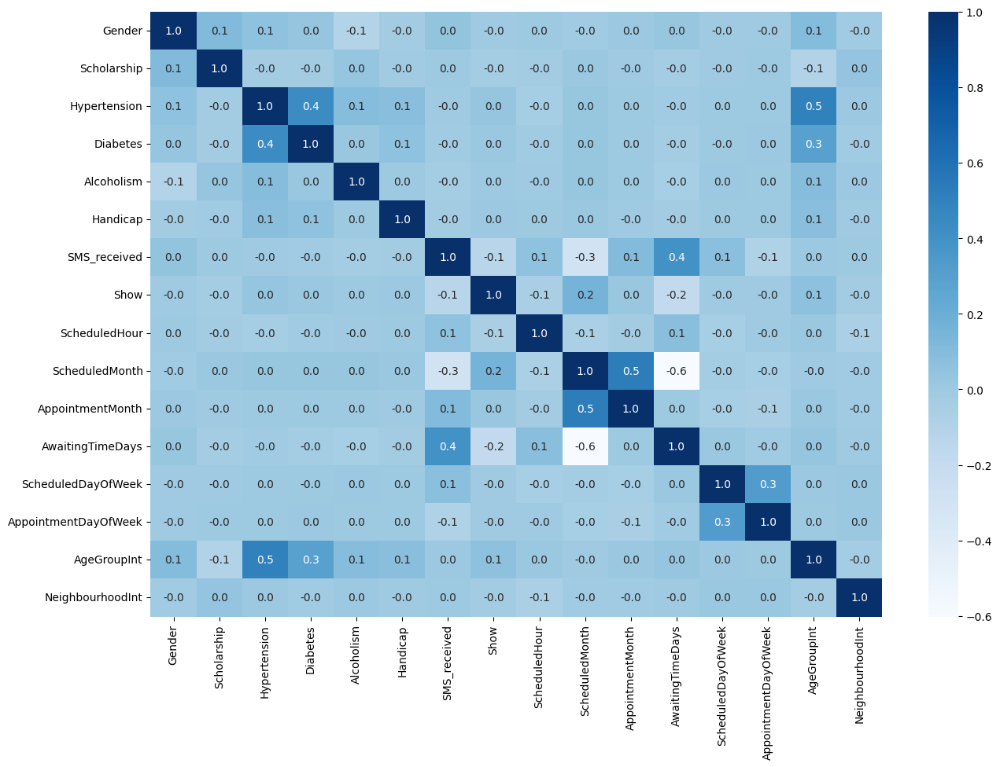

In [170]:
import seaborn as sns
import matplotlib.pyplot as plt


# check correlation between features use sns heatmap
plt.figure(figsize=(15, 10))
sns.heatmap(df.corr(), annot=True, fmt='.1f', cmap='Blues')
plt.show()